<a href="https://colab.research.google.com/github/kthom93/DeepLearning/blob/master/ClassBlendGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
import torch
import torchvision
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt

from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets
from torch.utils.data import Dataset, DataLoader

In [0]:
def normal_init(m, mean, std):
  if isinstance(m, nn.ConvTranspose2d) or isinstance(m, nn.Conv2d):
    m.weight.data.normal_(mean, std)
    m.bias.data.zero_()

class DiscriminatorNet(nn.Module):
  def __init__(self, d=128):
    super(DiscriminatorNet, self).__init__()
    self.conv1 = nn.Conv2d(3, d, 4, 2, 1)
    self.conv2 = nn.Conv2d(d, d*2, 4, 2, 1)
    self.conv2_bn = nn.BatchNorm2d(d*2)
    self.conv3 = nn.Conv2d(d*2, d*4, 4, 2, 1)
    self.conv3_bn = nn.BatchNorm2d(d*4)
    self.conv4 = nn.Conv2d(d*4, d*8, 4, 2, 1)
    self.conv4_bn = nn.BatchNorm2d(d*8)
    self.conv5 = nn.Conv2d(d*8, 1, 4, 1, 0)

  def weight_init(self, mean, std):
    for m in self._modules:
      normal_init(self._modules[m], mean, std)

  def forward(self, x):
    x = F.leaky_relu(self.conv1(x), 0.2)
    x = F.leaky_relu(self.conv2_bn(self.conv2(x)), 0.2)
    x = F.leaky_relu(self.conv3_bn(self.conv3(x)), 0.2)
    x = F.leaky_relu(self.conv4_bn(self.conv4(x)), 0.2)
    x = torch.sigmoid(self.conv5(x))

    return x
  # def __init__(self):
  #   super(DiscriminatorNet, self).__init__()
  #   n_features = 2500 #784
  #   n_out = 1
    
  #   self.hidden0 = nn.Sequential( 
  #       nn.Linear(n_features, 1024),
  #       nn.LeakyReLU(0.2),
  #       nn.Dropout(0.3)
  #   )
  #   self.hidden1 = nn.Sequential(
  #       nn.Linear(1024, 512),
  #       nn.LeakyReLU(0.2),
  #       nn.Dropout(0.3)
  #   )
  #   self.hidden2 = nn.Sequential(
  #       nn.Linear(512, 256),
  #       nn.LeakyReLU(0.2),
  #       nn.Dropout(0.3)
  #   )
  #   self.out = nn.Sequential(
  #       torch.nn.Linear(256, n_out),
  #       torch.nn.Sigmoid()
  #   )

  # def forward(self, x):
  #   x = self.hidden0(x)
  #   x = self.hidden1(x)
  #   x = self.hidden2(x)
  #   x = self.out(x)
  #   return x

class GeneratorNet(nn.Module):
  def __init__(self, d=128):
    super(GeneratorNet, self).__init__()
    self.deconv1 = nn.ConvTranspose2d(100, d*8, 4, 1, 0)
    self.deconv1_bn = nn.BatchNorm2d(d*8)
    self.deconv2 = nn.ConvTranspose2d(d*8, d*4, 4, 2, 1)
    self.deconv2_bn = nn.BatchNorm2d(d*4)
    self.deconv3 = nn.ConvTranspose2d(d*4, d*2, 4, 2, 1)
    self.deconv3_bn = nn.BatchNorm2d(d*2)
    self.deconv4 = nn.ConvTranspose2d(d*2, d, 4, 2, 1)
    self.deconv4_bn = nn.BatchNorm2d(d)
    self.deconv5 = nn.ConvTranspose2d(d, 3, 4, 2, 1)

  def weight_init(self, mean, std):
    for m in self._modules:
      normal_init(self._modules[m], mean, std)

  def forward(self, x):
    x = F.relu(self.deconv1_bn(self.deconv1(x)))
    x = F.relu(self.deconv2_bn(self.deconv2(x)))
    x = F.relu(self.deconv3_bn(self.deconv3(x)))
    x = F.relu(self.deconv4_bn(self.deconv4(x)))
    x = torch.tanh(self.deconv5(x))

    return x
  # def __init__(self):
  #   super(GeneratorNet, self).__init__()
  #   n_features = 100
  #   n_out = 2500 #784
    
  #   self.hidden0 = nn.Sequential(
  #       nn.Linear(n_features, 256),
  #       nn.LeakyReLU(0.2)
  #   )
  #   self.hidden1 = nn.Sequential(            
  #       nn.Linear(256, 512),
  #       nn.LeakyReLU(0.2)
  #   )
  #   self.hidden2 = nn.Sequential(
  #       nn.Linear(512, 1024),
  #       nn.LeakyReLU(0.2)
  #   )
    
  #   self.out = nn.Sequential(
  #       nn.Linear(1024, n_out),
  #       nn.Tanh()
  #   )

  # def forward(self, x):
  #   x = self.hidden0(x)
  #   x = self.hidden1(x)
  #   x = self.hidden2(x)
  #   x = self.out(x)
  #   return x


In [0]:
class STLClassDataset(Dataset):
  def __init__(self, data, transform=None):
    self.data = data
    self.transform = transform

  def __getitem__(self, index):
    return self.data[index]

  def __len__(self):
    return len(self.data)

In [0]:
def mnist_data():
  compose = transforms.Compose([transforms.ToTensor()])
  out_dir = './mnist_dataset'
  mnist_data = datasets.MNIST(root=out_dir, train=True, transform=compose, download=True)
  return DataLoader(mnist_data, batch_size=64, shuffle=True)

def stl_data(c1, c2):
  compose = transforms.Compose([
                                transforms.Resize(size=(64, 64)),
                                transforms.ToTensor()
                                ])
  out_dir = '/stl10_dataset'
  stl_data = datasets.STL10(root='out_dir', split='train', transform=compose, download=True)

  d1 = []
  d2 = []

  for index, data in enumerate(stl_data):
    img, c = data
    if c == c1:
      d1.append(img)
    if c == c2:
      d2.append(img)

  data1 = STLClassDataset(d1)
  data2 = STLClassDataset(d2)

  data_loader1 = DataLoader(data1, batch_size=100, shuffle=True)
  data_loader2 = DataLoader(data1, batch_size=100, shuffle=True)
  return data_loader1, data_loader2

In [0]:
def showImages(generator, test_noise, epoch):
  print('Epoch Number %i' % epoch)

  test_images = generator(test_noise)
  test_images = test_images.data.cpu()
  fig, ax = plt.subplots(1, 4, figsize=(10, 40))
  ax[0].imshow(transforms.ToPILImage()(test_images[0]))
  ax[1].imshow(transforms.ToPILImage()(test_images[1]))
  ax[2].imshow(transforms.ToPILImage()(test_images[2]))
  ax[3].imshow(transforms.ToPILImage()(test_images[3]))
  plt.show()

def noise(size):
  return torch.randn(size, 100).view(-1, 100, 1, 1).cuda()

def images_to_vectors(images):
  return images.view(images.size(0), 2500) # 784)

def vectors_to_images(vectors):
  return vectors.view(vectors.size(0), 1, 50, 50) #28, 28)

def ones_target(size):
  data = Variable(torch.ones(size, 1)).cuda()
  return data

def zeros_target(size):
  data = Variable(torch.zeros(size, 1)).cuda()
  return data

def scope(G, D1, D2, data_loader1, data_loader2, switch=100, epochs=1000, chart_num=20, num_samples=4, lr=0.0002):
  test_noise = noise(num_samples)
  G_optimizer = optim.Adam(G.parameters(), lr=lr)
  D1_optimizer = optim.Adam(D1.parameters(), lr=lr)
  D2_optimizer = optim.Adam(D2.parameters(), lr=lr)
  loss = nn.BCELoss()

  # G_loss = []
  # D_loss = []
  G1_loss = []
  G2_loss = []
  D1_loss = []
  D2_loss = []

  # D = D1
  # D_optimizer = D1_optimizer
  # data_loader = data_loader1
  for epoch in range(epochs):
    if epoch % chart_num == 0:
      showImages(G, test_noise, epoch)
    # if epoch % switch == 0:
    #   if D == D1:
    #     D = D2
    #     D_optimizer = D2_optimizer
    #     data_loader = data_loader2
    #   else:
    #     D = D1
    #     D_optimizer = D1_optimizer
    #     data_loader = data_loader1

    count = 0
    G_loss_per_epoch = 0
    D_loss_per_epoch = 0

    for n_batch, real_batch in enumerate(data_loader1):
      N = real_batch.size(0)
      real_data = real_batch.cuda()
      fake_data = G(noise(N)).detach()
      D1_optimizer.zero_grad()

      prediction_real = D1(real_data)
      error_real = loss(prediction_real, ones_target(N))
      error_real.backward()

      prediction_fake = D1(fake_data)
      error_fake = loss(prediction_fake, zeros_target(N))
      error_fake.backward()
      D_loss_per_epoch += error_real.item() + error_fake.item()
      D1_optimizer.step()
      
      fake_data = G(noise(N))
      G_optimizer.zero_grad()
      prediction = D1(fake_data)
      error = loss(prediction, ones_target(N))
      G_loss_per_epoch += error.item()
      error.backward()
      G_optimizer.step()

      count += 1
    
    G1_loss.append(G_loss_per_epoch / count)
    D1_loss.append(D_loss_per_epoch / count)

    count = 0
    G_loss_per_epoch = 0
    D_loss_per_epoch = 0

    for n_batch, real_batch in enumerate(data_loader2):
      N = real_batch.size(0)
      real_data = real_batch.cuda()
      fake_data = G(noise(N)).detach()
      D2_optimizer.zero_grad()

      prediction_real = D2(real_data)
      error_real = loss(prediction_real, ones_target(N))
      error_real.backward()

      prediction_fake = D2(fake_data)
      error_fake = loss(prediction_fake, zeros_target(N))
      error_fake.backward()
      D_loss_per_epoch += error_real.item() + error_fake.item()
      D2_optimizer.step()
      
      fake_data = G(noise(N))
      G_optimizer.zero_grad()
      prediction = D2(fake_data)
      error = loss(prediction, ones_target(N))
      G_loss_per_epoch += error.item()
      error.backward()
      G_optimizer.step()

      count += 1
    
    G2_loss.append(G_loss_per_epoch / count)
    D2_loss.append(D_loss_per_epoch / count)
  plt.plot(G1_loss)
  plt.show()
  plt.plot(G2_loss)
  plt.show()
  plt.plot(D1_loss)
  plt.show()
  plt.plot(D2_loss)
  plt.show()
  return G, D1, D2


In [0]:
G = GeneratorNet()
D1 = DiscriminatorNet()
D2 = DiscriminatorNet()

G.load_state_dict(torch.load('/content/drive/My Drive/Gct2'))
D1.load_state_dict(torch.load('/content/drive/My Drive/D1ct2'))
D2.load_state_dict(torch.load('/content/drive/My Drive/D2ct2'))

G, D1, D2 = G.cuda(), D1.cuda(), D2.cuda()
# G.weight_init(mean=0.0, std=0.02)
# D.weight_init(mean=0.0, std=0.02)

# # mnist_data_loader = mnist_data()
stl_data_loader1, stl_data_loader2 = stl_data(3, 9)

Files already downloaded and verified


Epoch Number 0


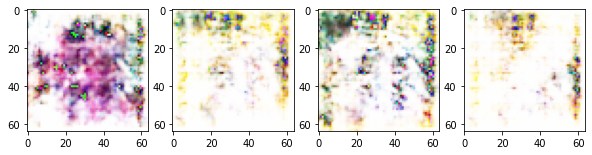

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:498: UserWarning: Using a target size (torch.Size([100, 1])) that is different to the input size (torch.Size([100, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


Epoch Number 20


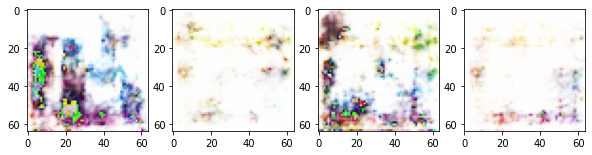

Epoch Number 40


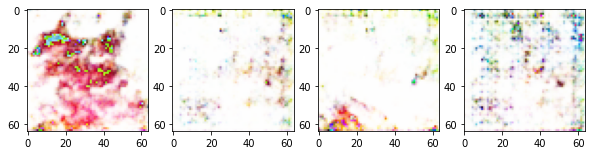

Epoch Number 60


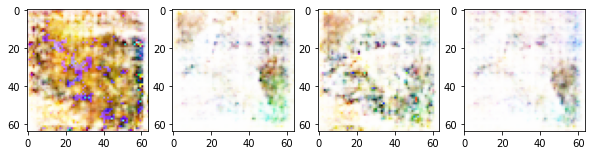

Epoch Number 80


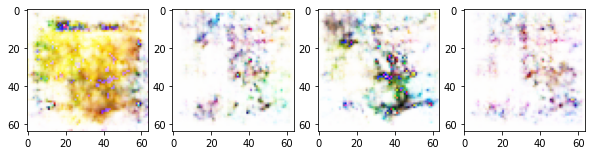

Epoch Number 100


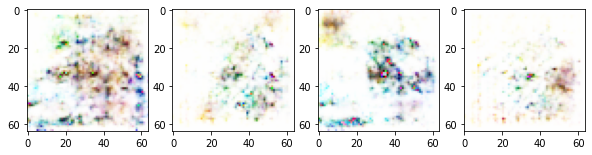

Epoch Number 120


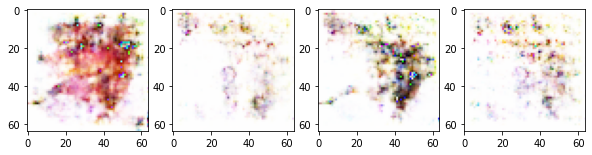

Epoch Number 140


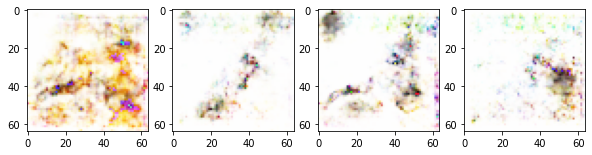

Epoch Number 160


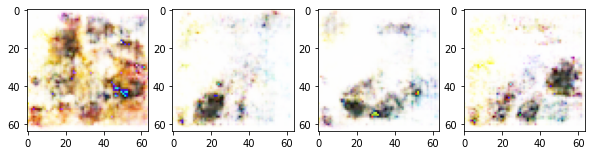

Epoch Number 180


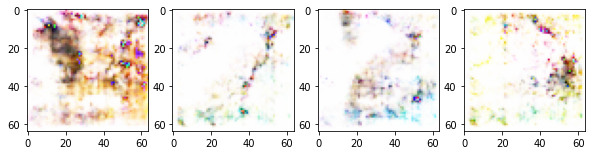

Epoch Number 200


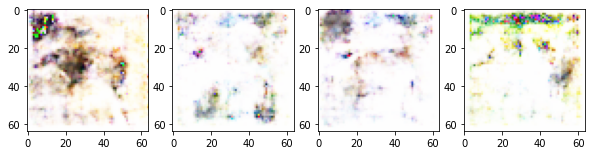

Epoch Number 220


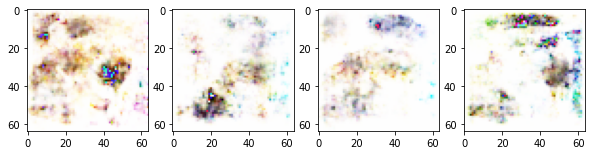

Epoch Number 240


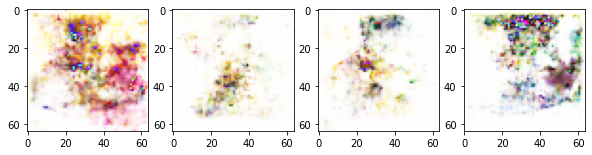

Epoch Number 260


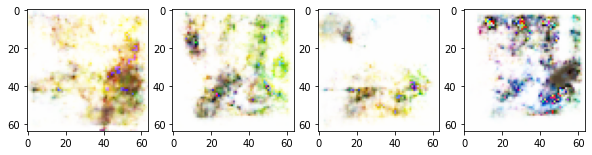

Epoch Number 280


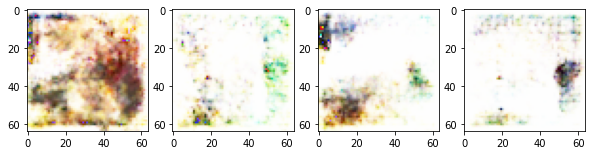

Epoch Number 300


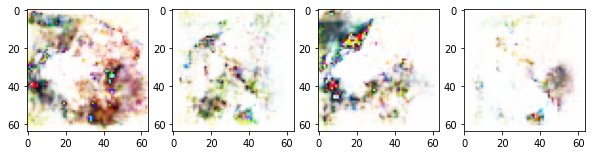

Epoch Number 320


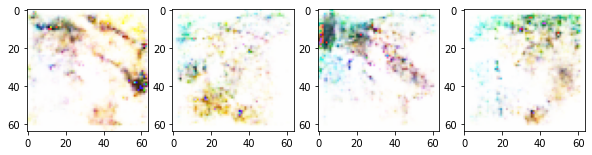

Epoch Number 340


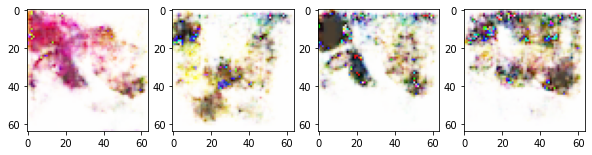

Epoch Number 360


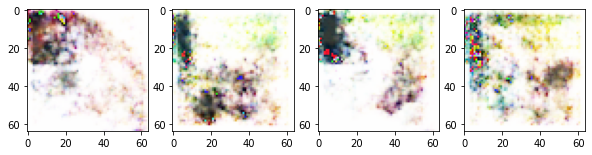

Epoch Number 380


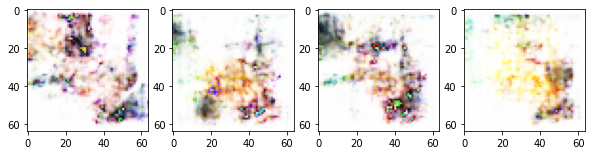

Epoch Number 400


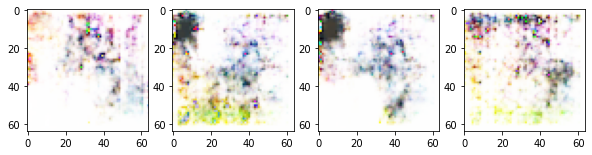

Epoch Number 420


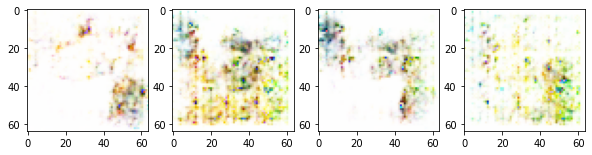

Epoch Number 440


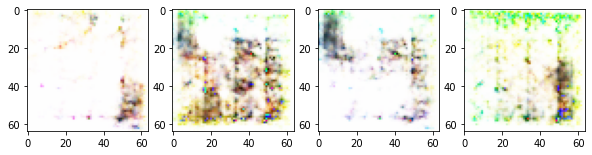

Epoch Number 460


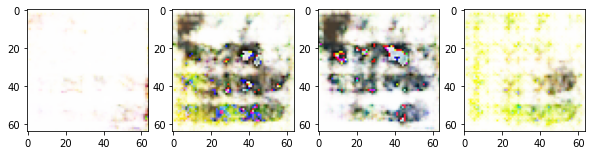

Epoch Number 480


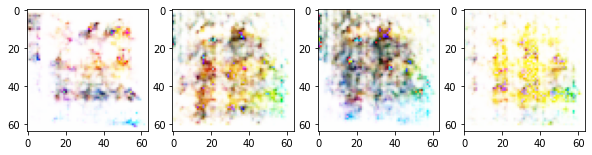

Epoch Number 500


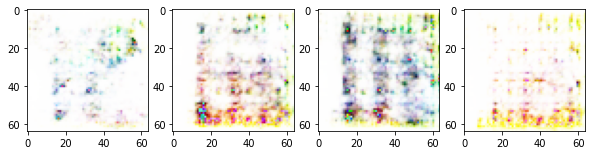

Epoch Number 520


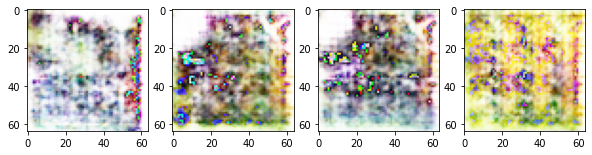

Epoch Number 540


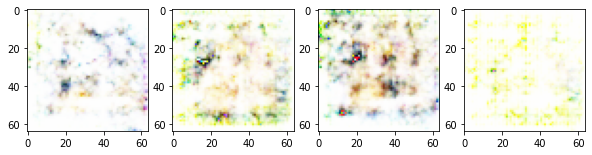

Epoch Number 560


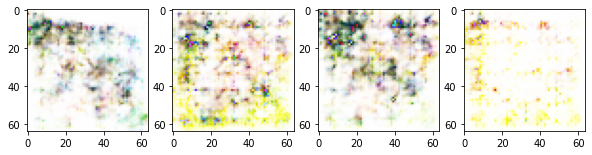

Epoch Number 580


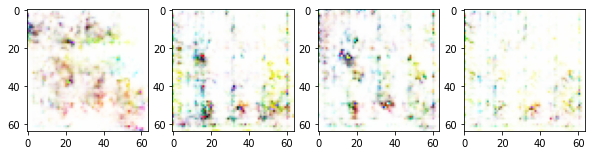

Epoch Number 600


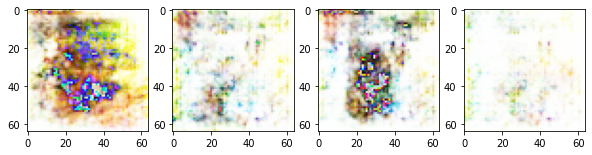

Epoch Number 620


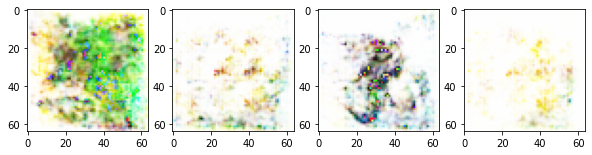

Epoch Number 640


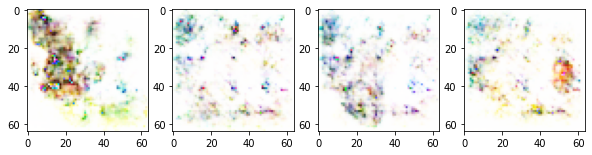

Epoch Number 660


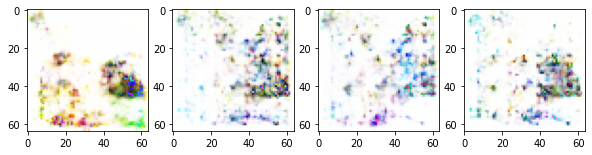

Epoch Number 680


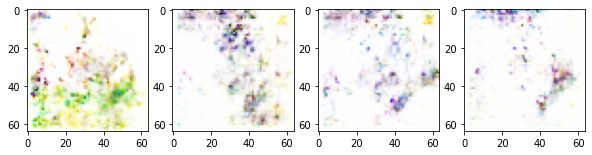

Epoch Number 700


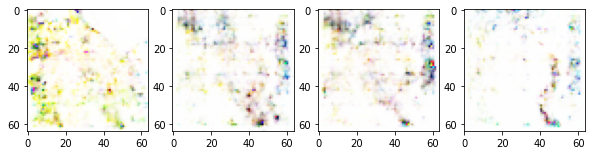

Epoch Number 720


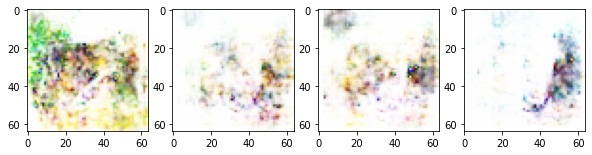

Epoch Number 740


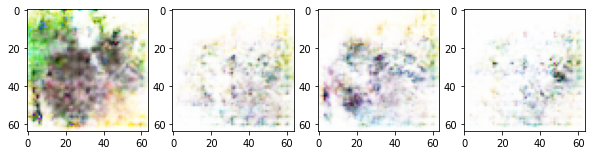

Epoch Number 760


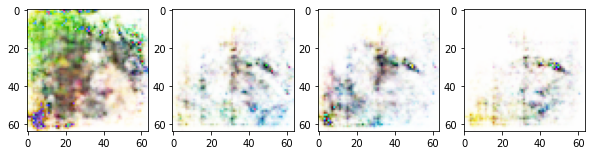

Epoch Number 780


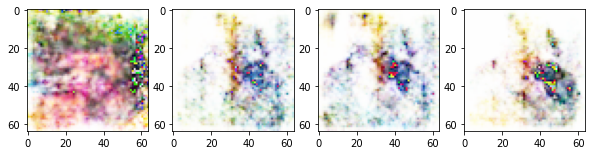

Epoch Number 800


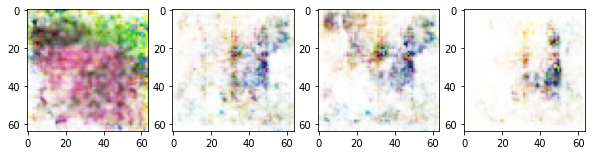

Epoch Number 820


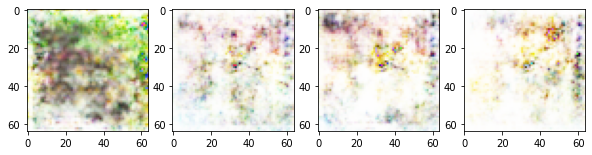

Epoch Number 840


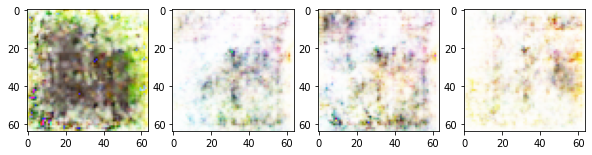

Epoch Number 860


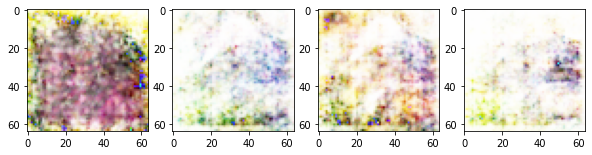

Epoch Number 880


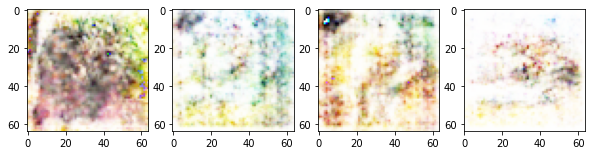

Epoch Number 900


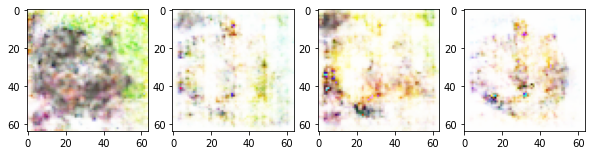

Epoch Number 920


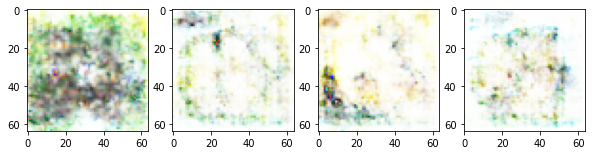

Epoch Number 940


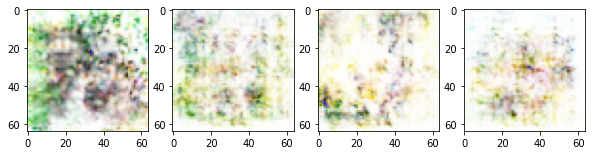

Epoch Number 960


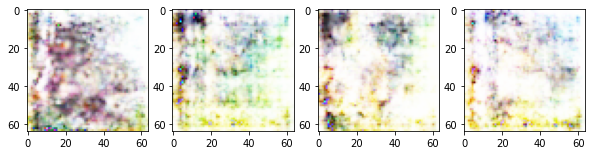

Epoch Number 980


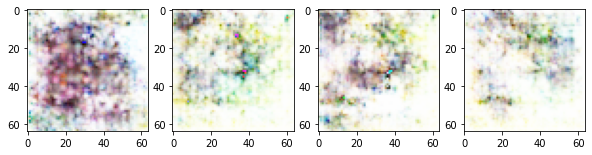

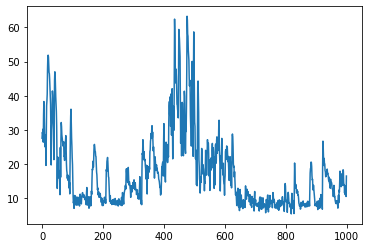

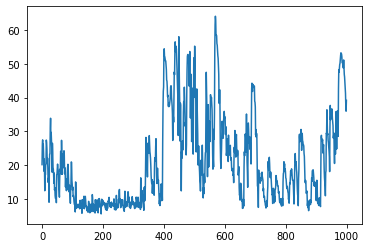

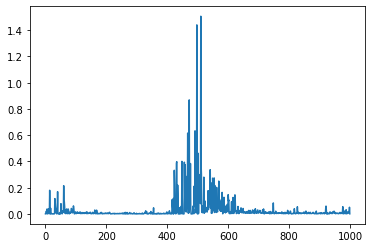

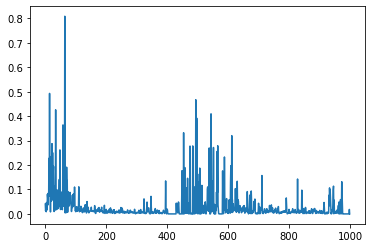

In [0]:
G, D1, D2 = scope(G, D1, D2, stl_data_loader1, stl_data_loader2)

Epoch Number 0


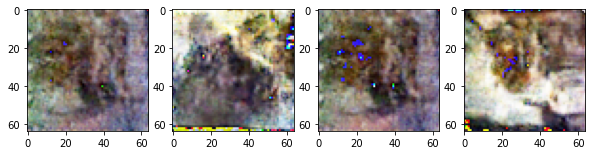

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:498: UserWarning: Using a target size (torch.Size([100, 1])) that is different to the input size (torch.Size([100, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


Epoch Number 20


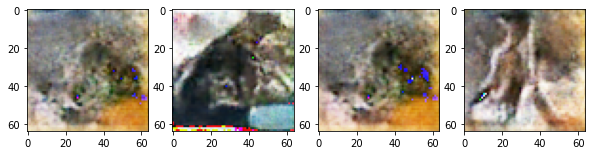

Epoch Number 40


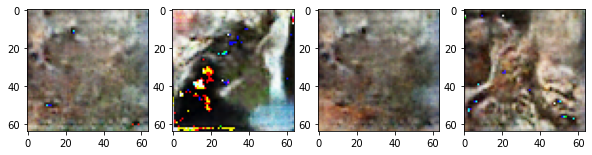

Epoch Number 60


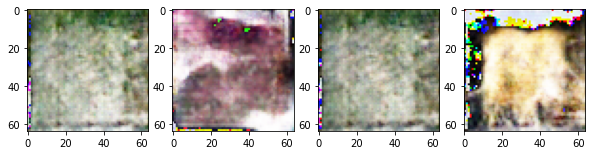

Epoch Number 80


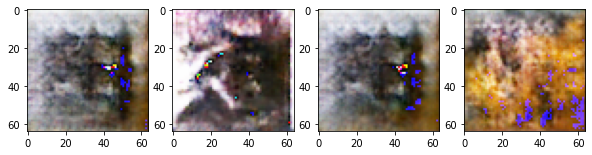

Epoch Number 100


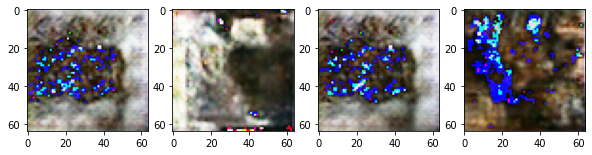

Epoch Number 120


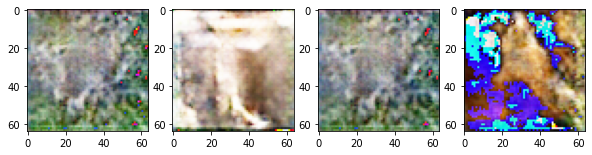

Epoch Number 140


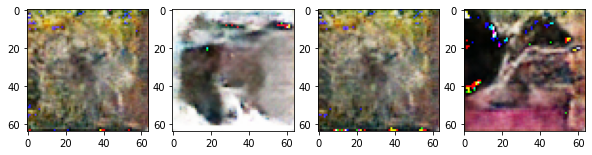

Epoch Number 160


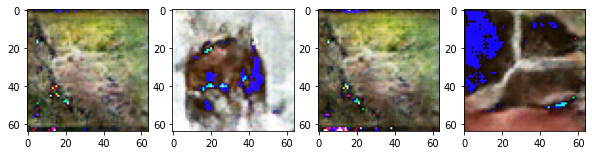

Epoch Number 180


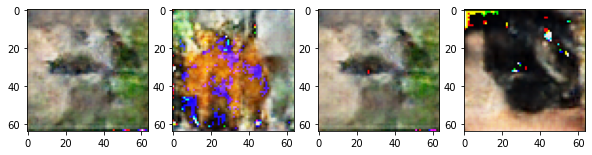

Epoch Number 200


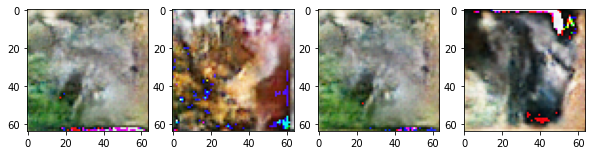

Epoch Number 220


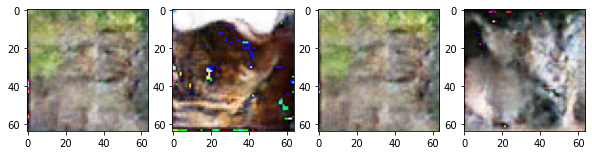

Epoch Number 240


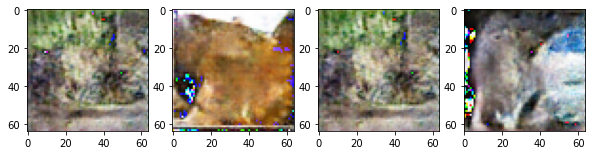

Epoch Number 260


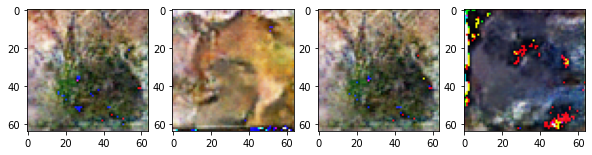

Epoch Number 280


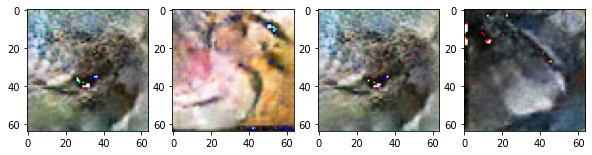

Epoch Number 300


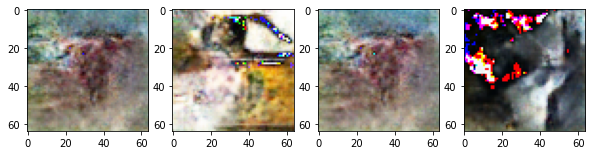

Epoch Number 320


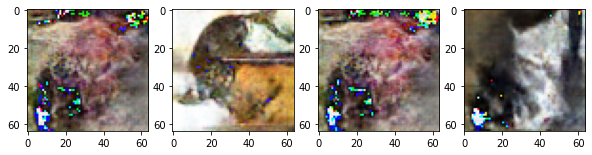

Epoch Number 340


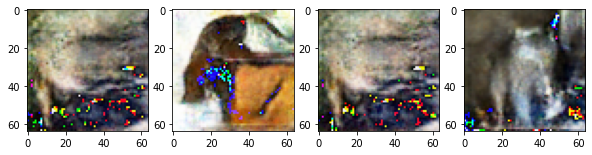

Epoch Number 360


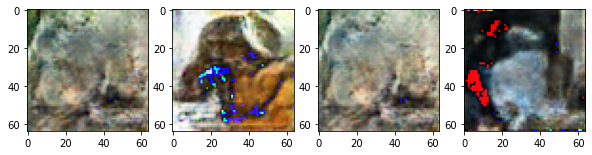

Epoch Number 380


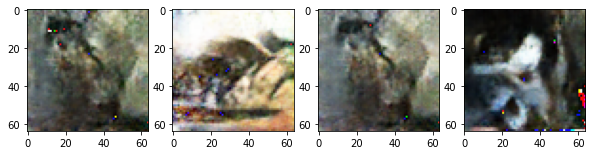

Epoch Number 400


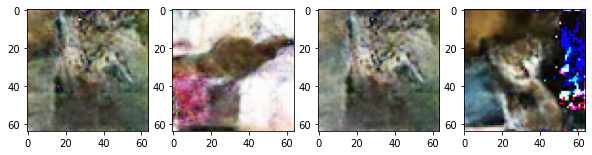

Epoch Number 420


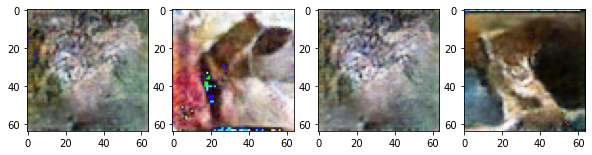

Epoch Number 440


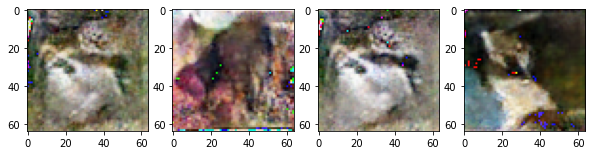

Epoch Number 460


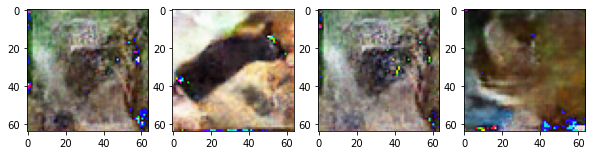

Epoch Number 480


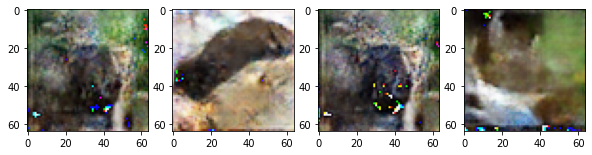

Epoch Number 500


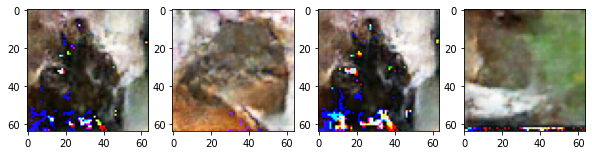

Epoch Number 520


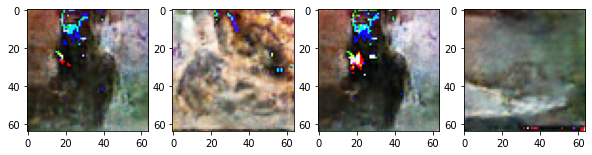

Epoch Number 540


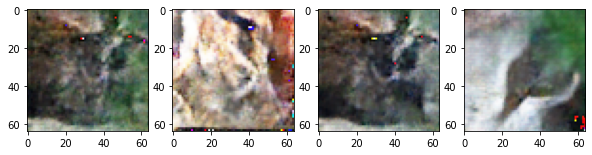

Epoch Number 560


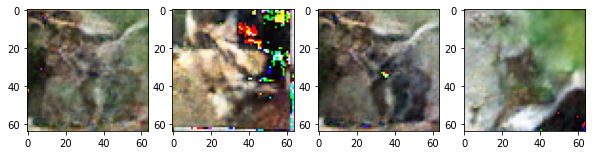

Epoch Number 580


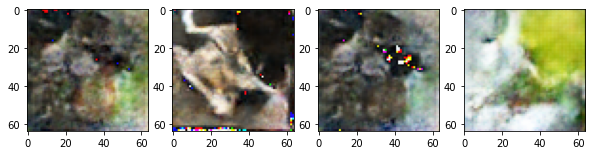

Epoch Number 600


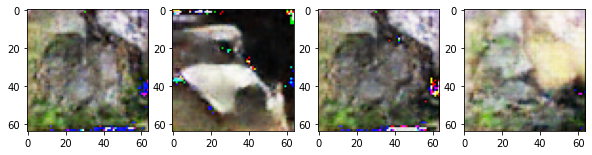

Epoch Number 620


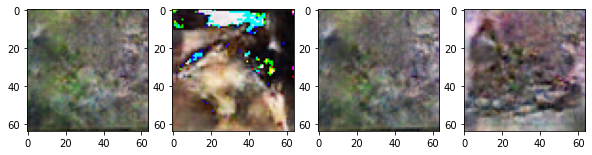

Epoch Number 640


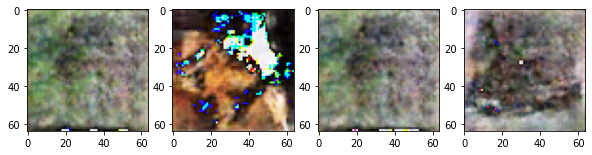

Epoch Number 660


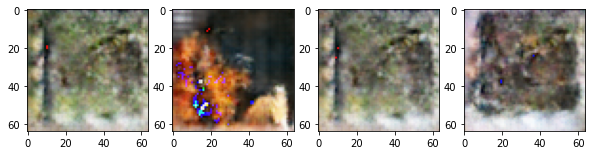

Epoch Number 680


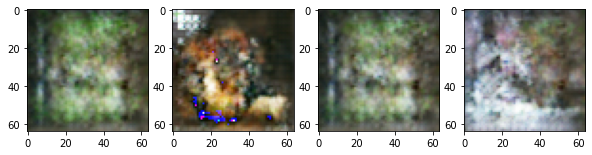

Epoch Number 700


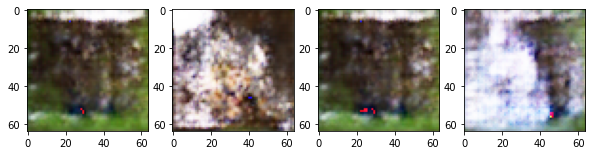

Epoch Number 720


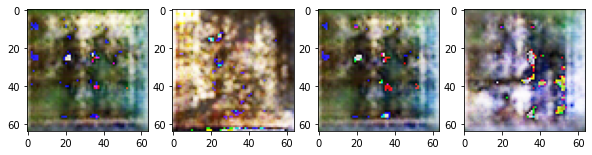

Epoch Number 740


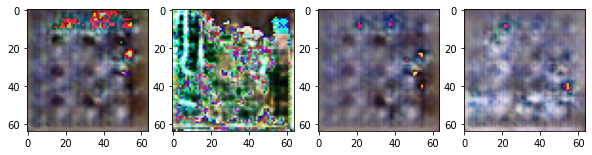

Epoch Number 760


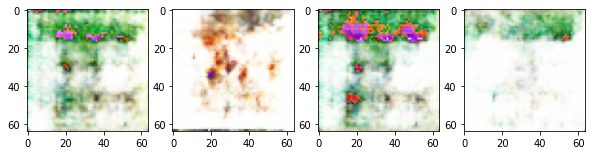

Epoch Number 780


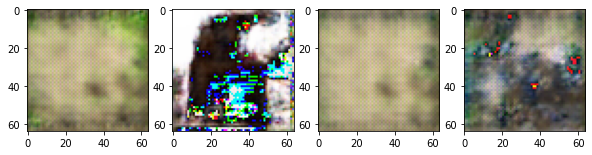

Epoch Number 800


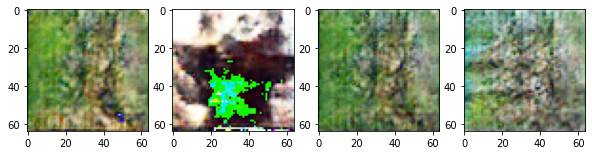

Epoch Number 820


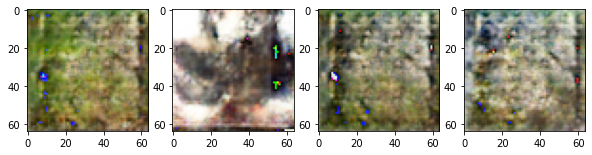

Epoch Number 840


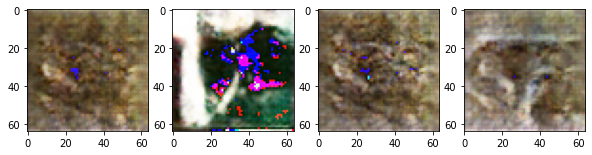

Epoch Number 860


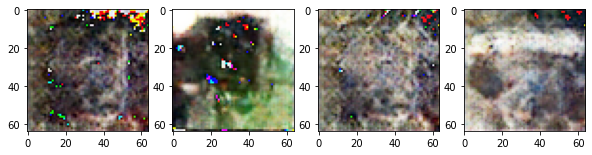

Epoch Number 880


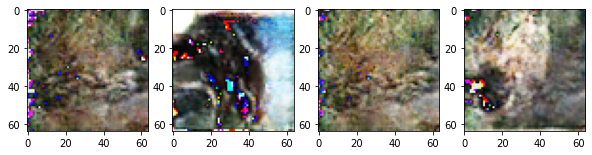

Epoch Number 900


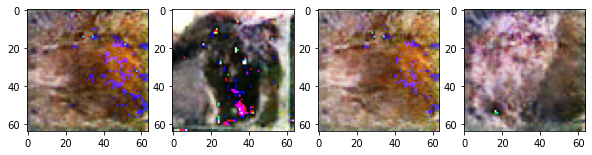

Epoch Number 920


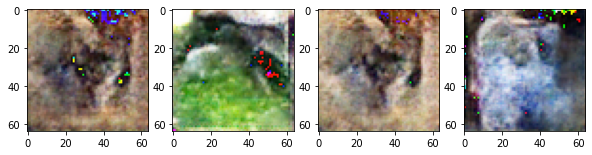

Epoch Number 940


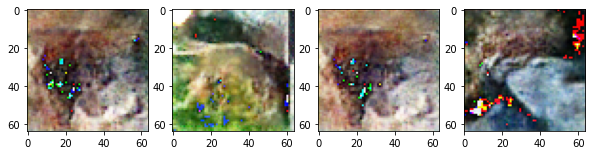

Epoch Number 960


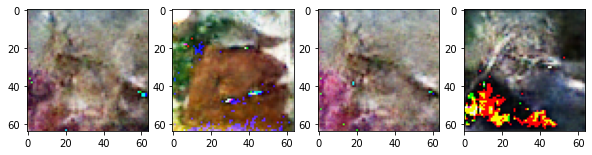

Epoch Number 980


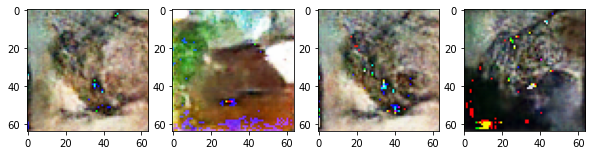

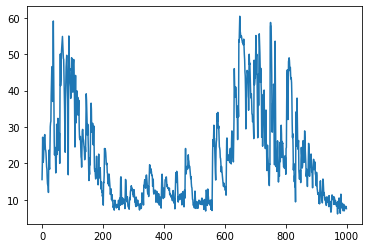

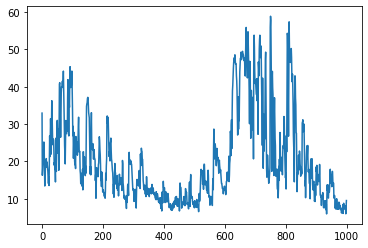

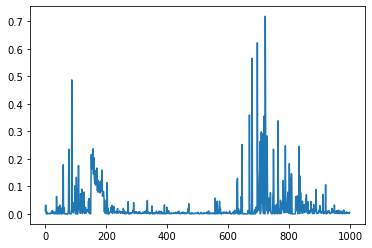

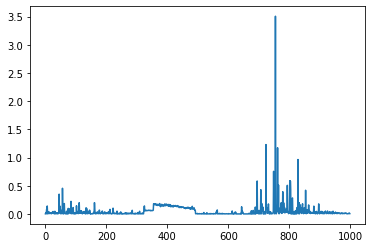

In [0]:
G, D1, D2 = scope(G, D1, D2, stl_data_loader1, stl_data_loader2)

Epoch Number 0


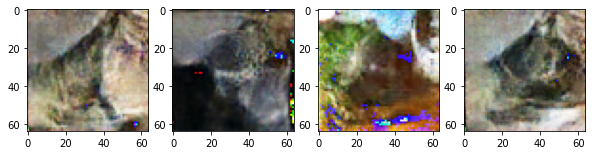

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:498: UserWarning: Using a target size (torch.Size([100, 1])) that is different to the input size (torch.Size([100, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


Epoch Number 20


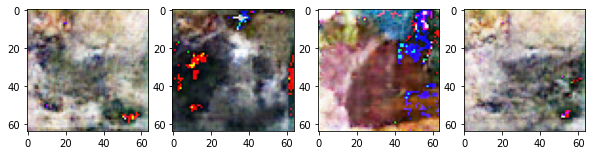

Epoch Number 40


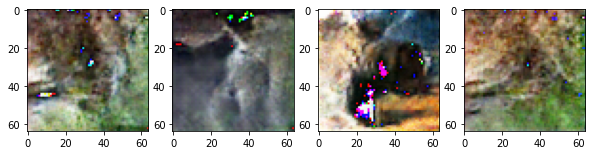

Epoch Number 60


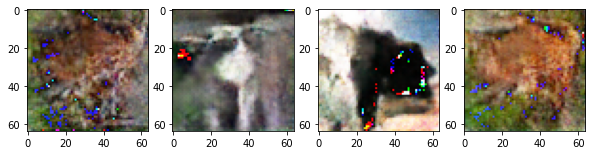

Epoch Number 80


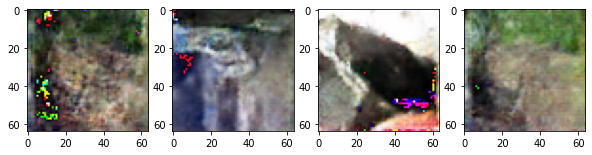

Epoch Number 100


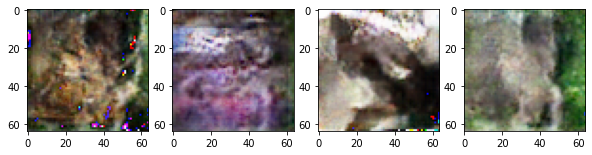

Epoch Number 120


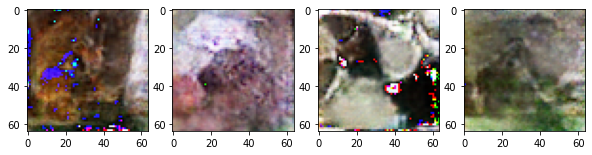

Epoch Number 140


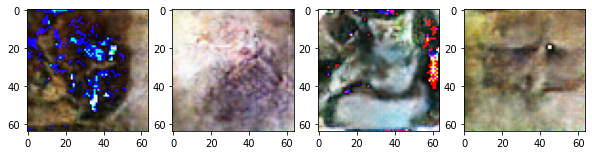

Epoch Number 160


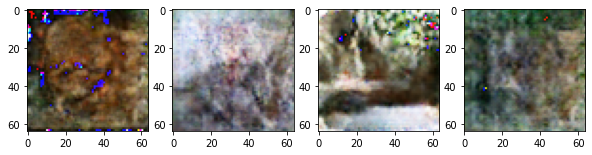

Epoch Number 180


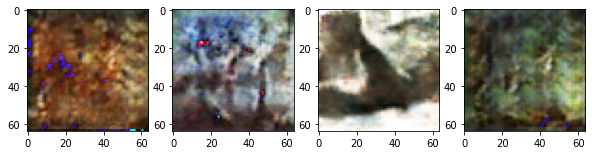

Epoch Number 200


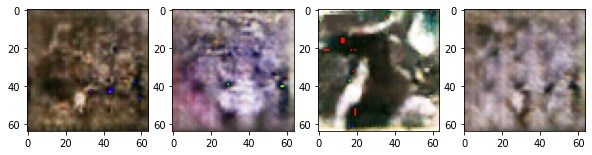

Epoch Number 220


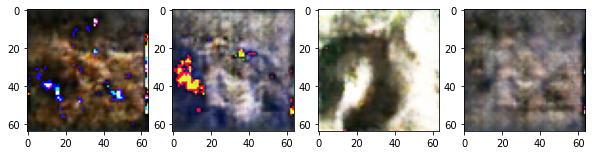

Epoch Number 240


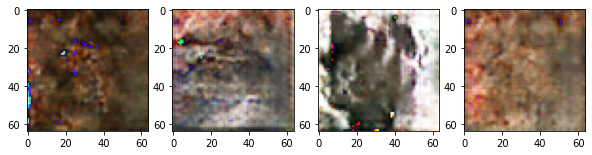

Epoch Number 260


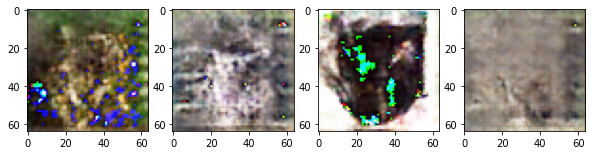

Epoch Number 280


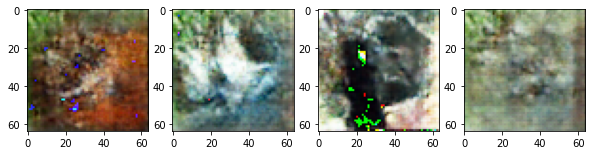

Epoch Number 300


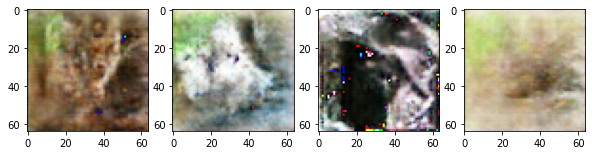

Epoch Number 320


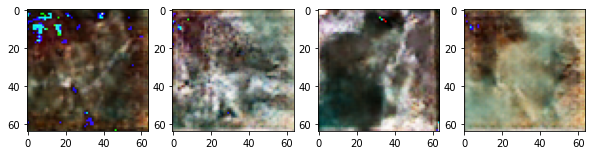

Epoch Number 340


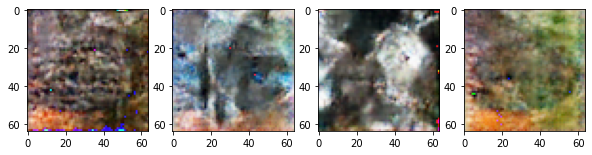

Epoch Number 360


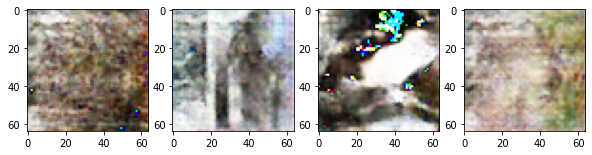

Epoch Number 380


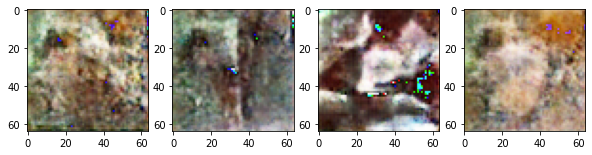

Epoch Number 400


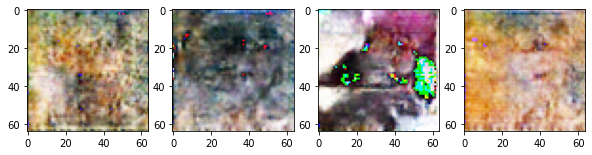

Epoch Number 420


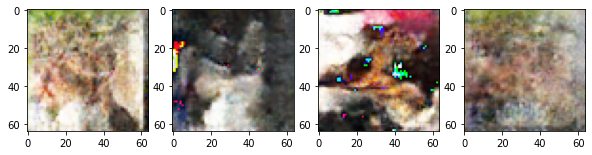

Epoch Number 440


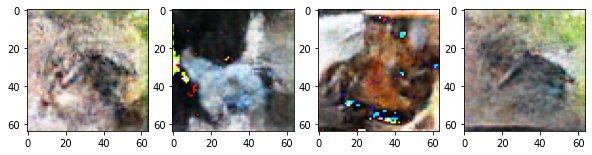

Epoch Number 460


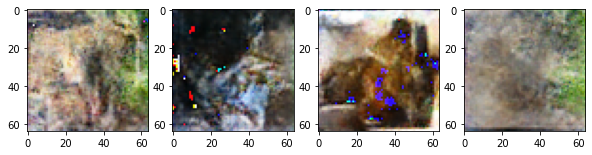

Epoch Number 480


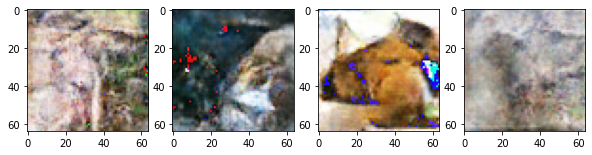

Epoch Number 500


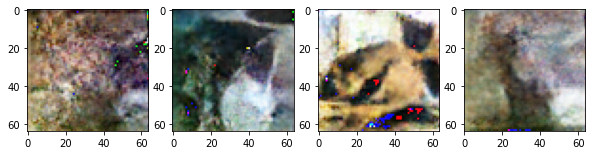

Epoch Number 520


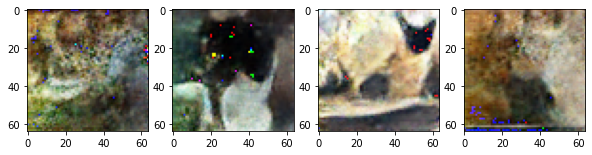

Epoch Number 540


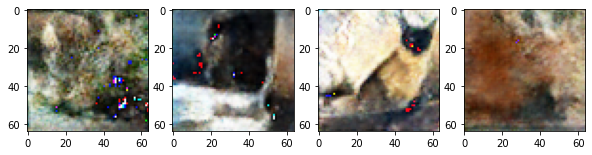

Epoch Number 560


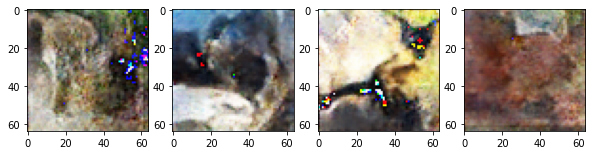

Epoch Number 580


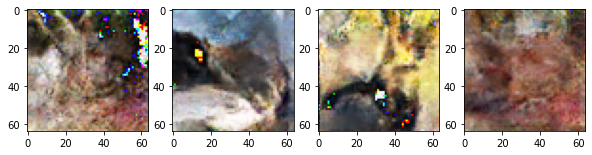

Epoch Number 600


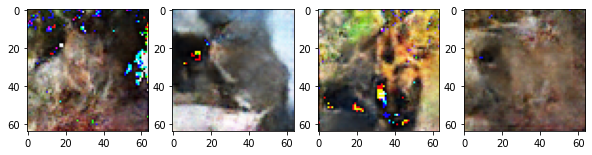

Epoch Number 620


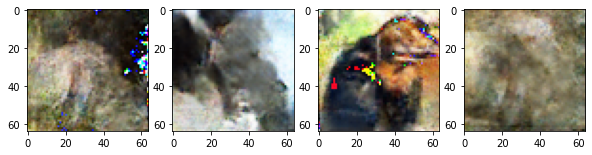

Epoch Number 640


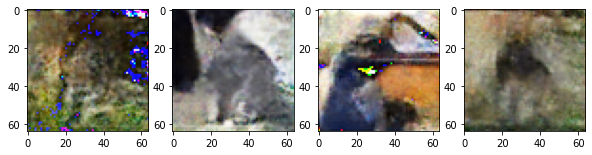

Epoch Number 660


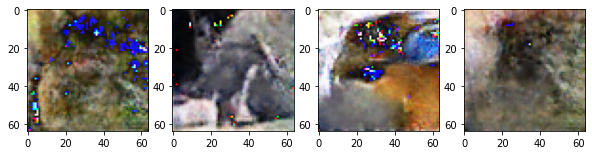

Epoch Number 680


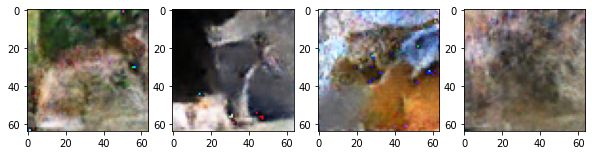

Epoch Number 700


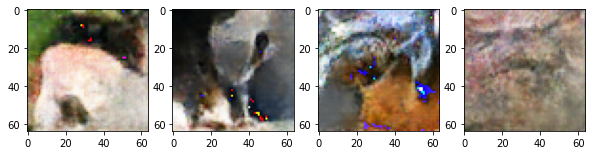

Epoch Number 720


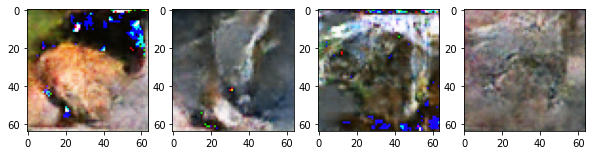

Epoch Number 740


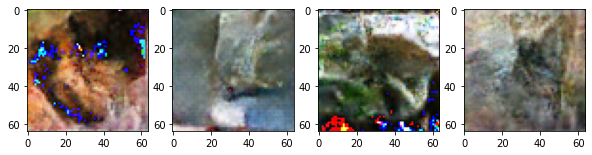

Epoch Number 760


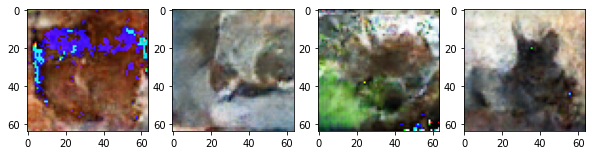

Epoch Number 780


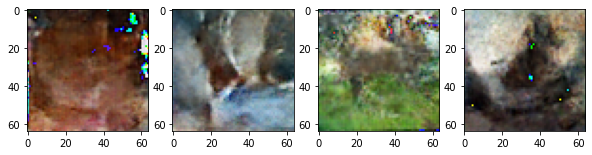

Epoch Number 800


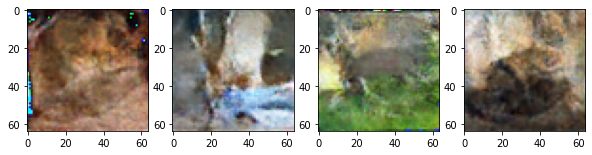

Epoch Number 820


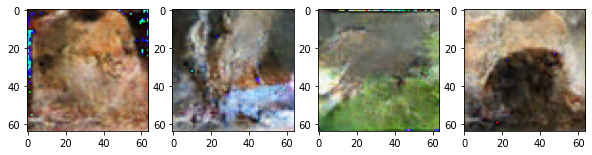

Epoch Number 840


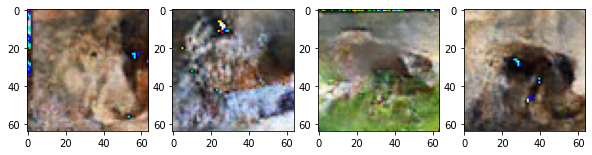

Epoch Number 860


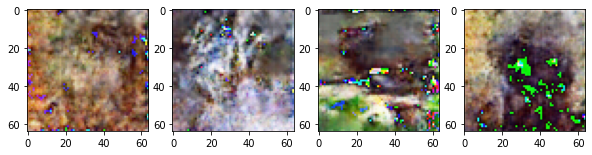

Epoch Number 880


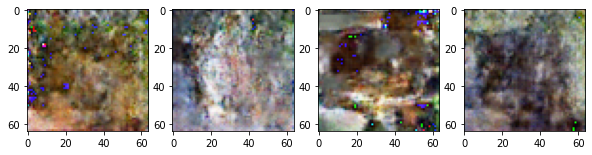

Epoch Number 900


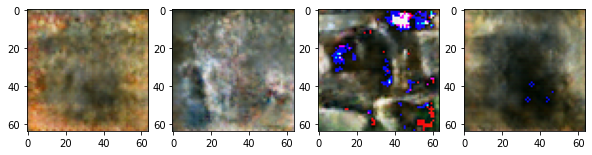

Epoch Number 920


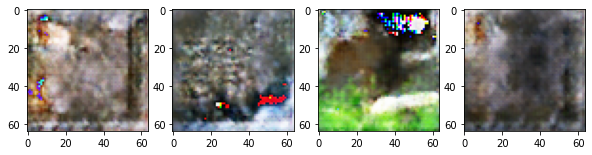

Epoch Number 940


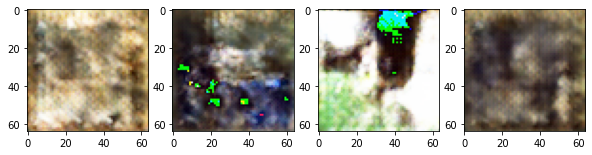

Epoch Number 960


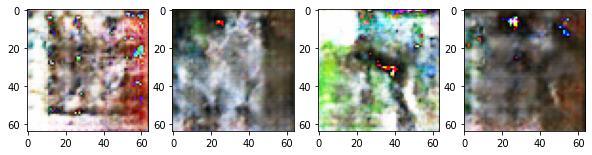

Epoch Number 980


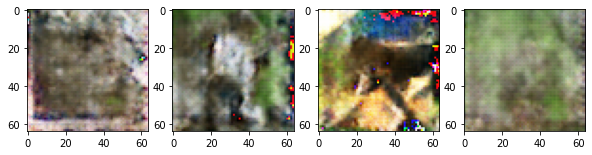

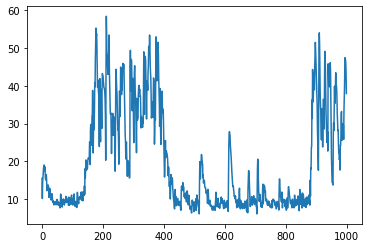

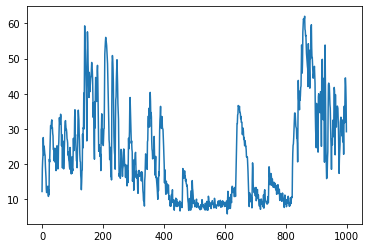

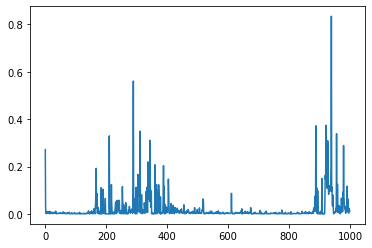

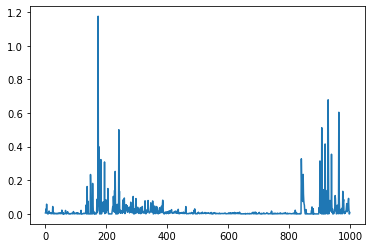

In [0]:
G, D1, D2 = scope(G, D1, D2, stl_data_loader1, stl_data_loader2)

Epoch Number 0


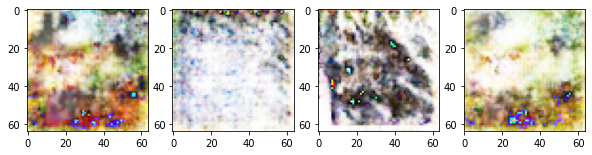

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:498: UserWarning: Using a target size (torch.Size([100, 1])) that is different to the input size (torch.Size([100, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


Epoch Number 20


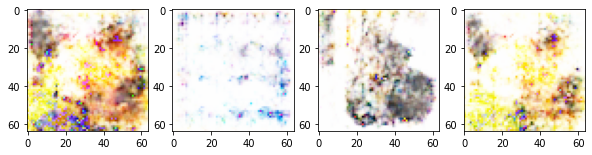

Epoch Number 40


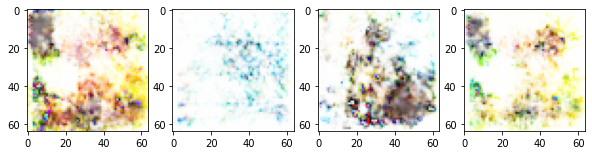

Epoch Number 60


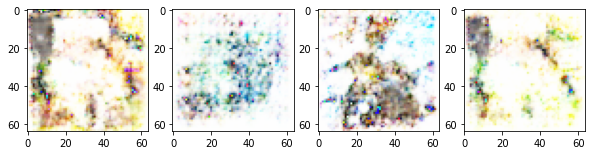

Epoch Number 80


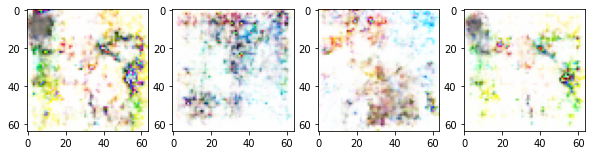

Epoch Number 100


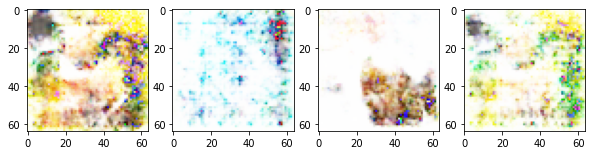

Epoch Number 120


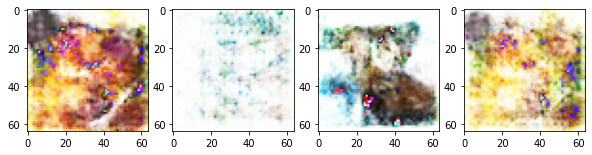

Epoch Number 140


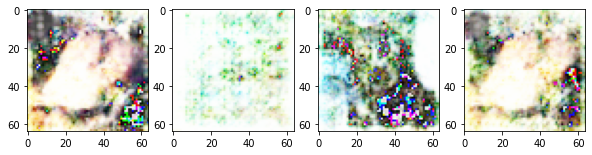

Epoch Number 160


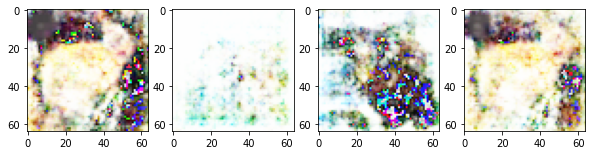

Epoch Number 180


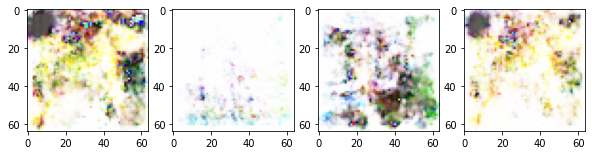

Epoch Number 200


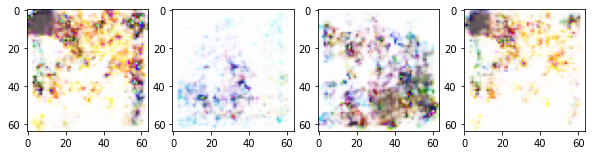

Epoch Number 220


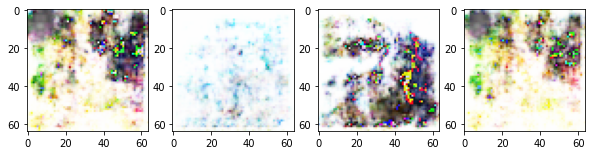

Epoch Number 240


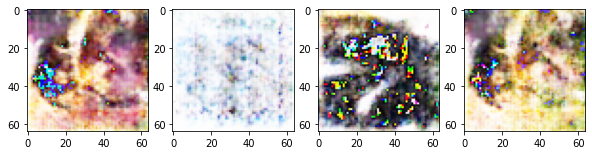

Epoch Number 260


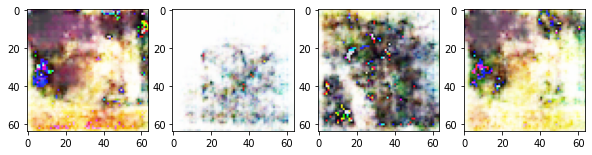

Epoch Number 280


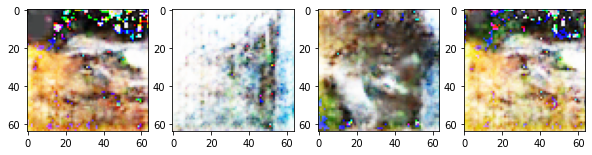

Epoch Number 300


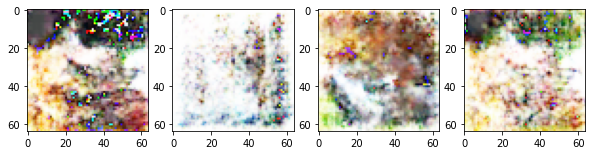

Epoch Number 320


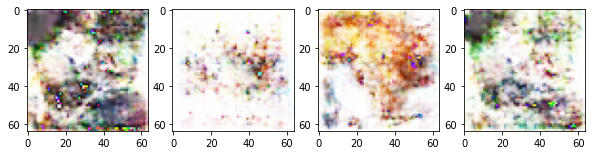

Epoch Number 340


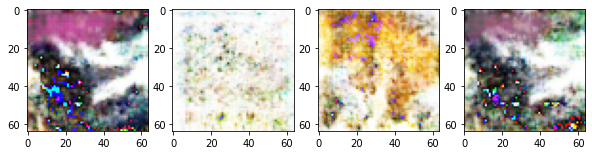

Epoch Number 360


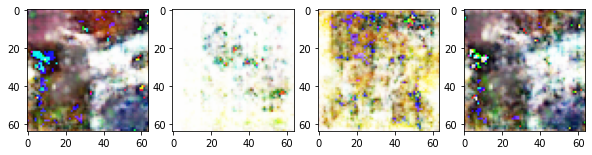

Epoch Number 380


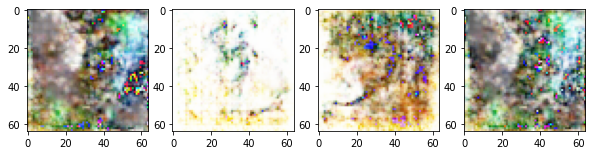

Epoch Number 400


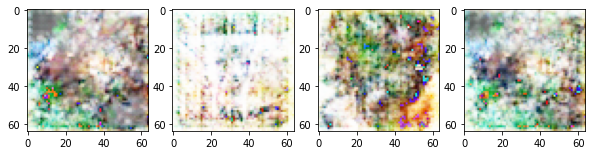

Epoch Number 420


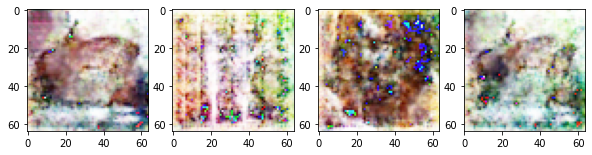

Epoch Number 440


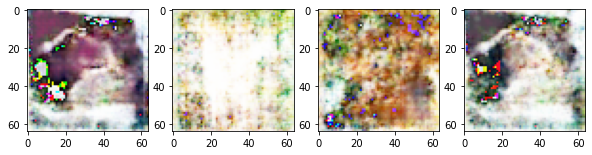

Epoch Number 460


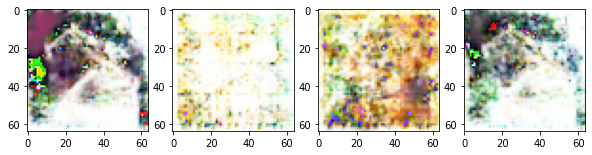

Epoch Number 480


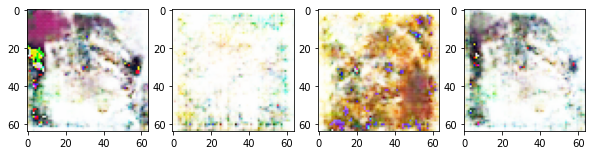

Epoch Number 500


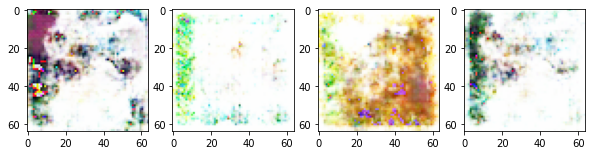

Epoch Number 520


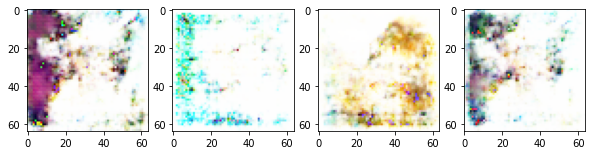

Epoch Number 540


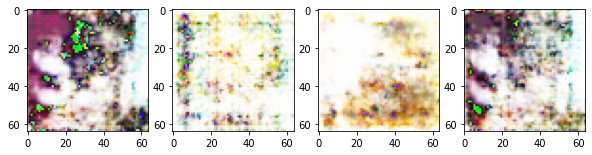

Epoch Number 560


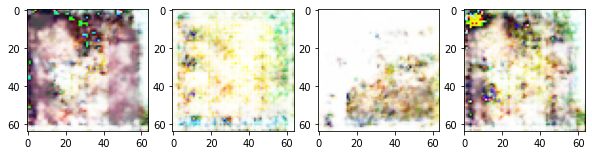

Epoch Number 580


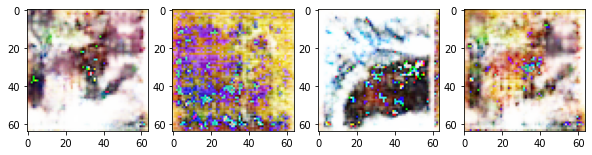

Epoch Number 600


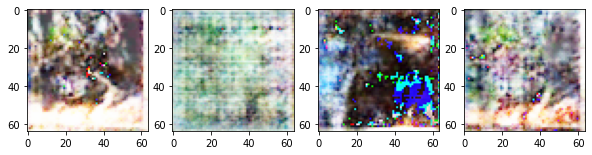

Epoch Number 620


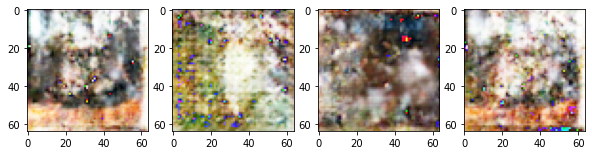

Epoch Number 640


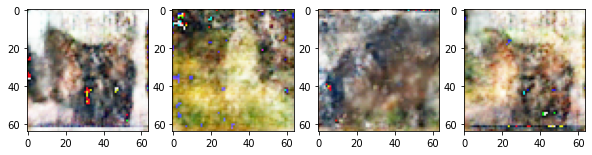

Epoch Number 660


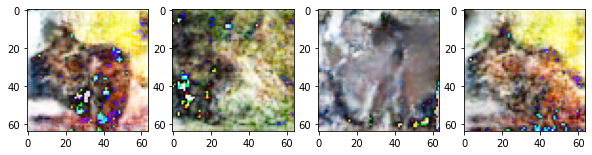

Epoch Number 680


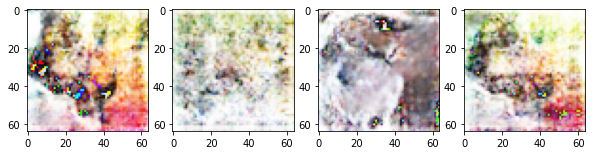

Epoch Number 700


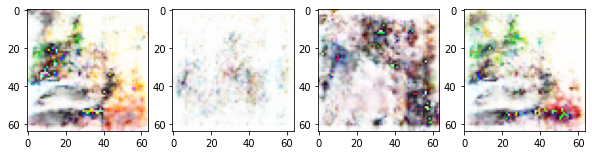

Epoch Number 720


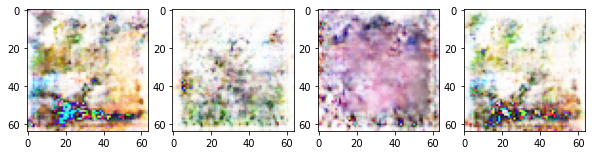

Epoch Number 740


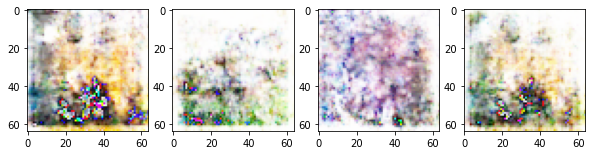

Epoch Number 760


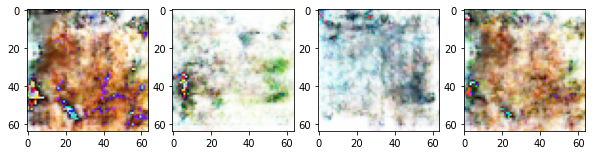

Epoch Number 780


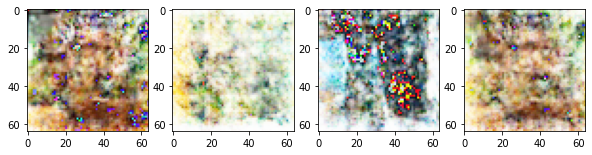

Epoch Number 800


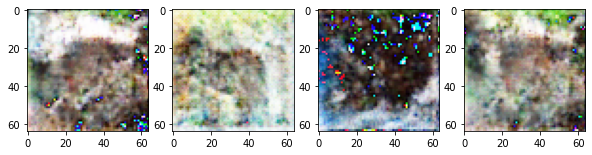

Epoch Number 820


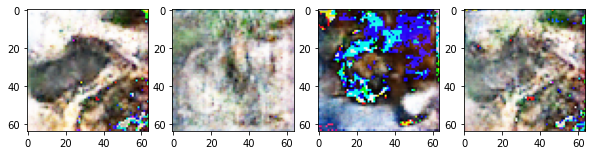

Epoch Number 840


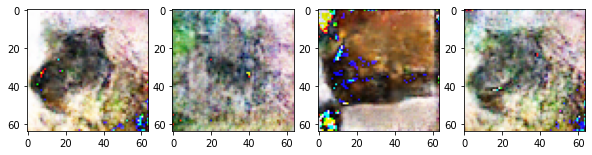

Epoch Number 860


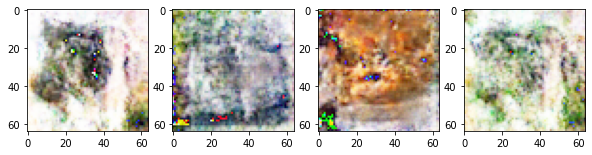

Epoch Number 880


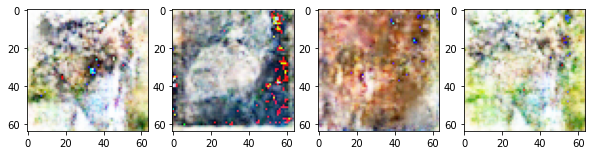

Epoch Number 900


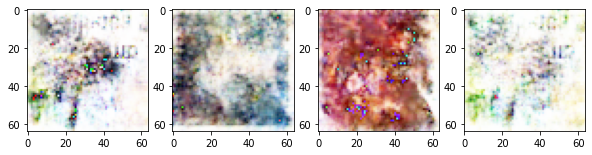

Epoch Number 920


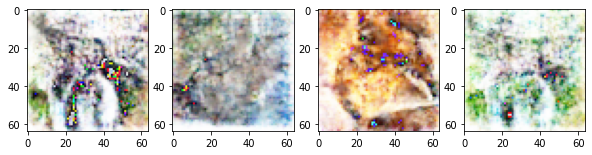

Epoch Number 940


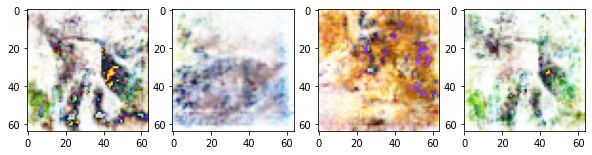

Epoch Number 960


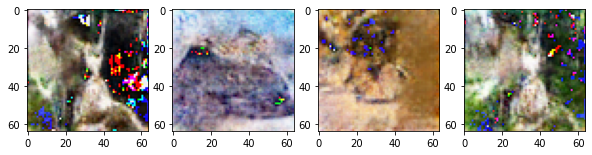

Epoch Number 980


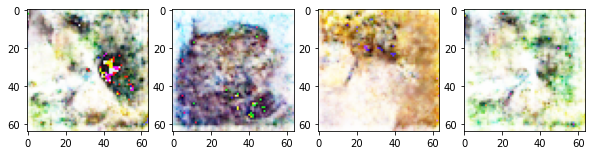

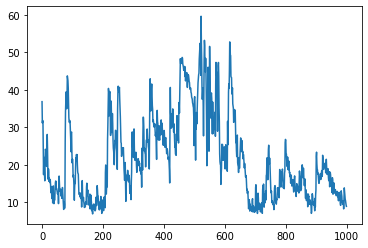

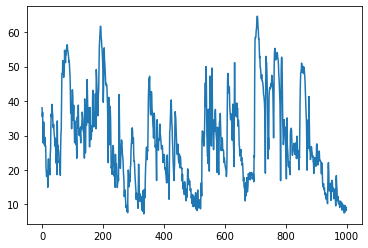

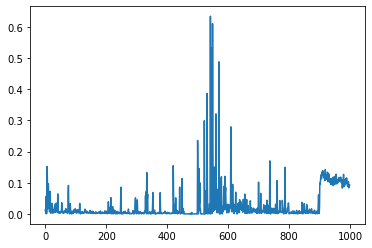

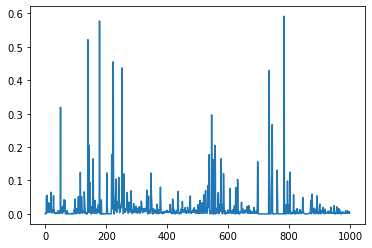

In [0]:
G, D1, D2 = scope(G, D1, D2, stl_data_loader1, stl_data_loader2)

Epoch Number 0


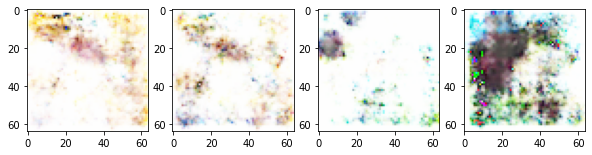

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:498: UserWarning: Using a target size (torch.Size([100, 1])) that is different to the input size (torch.Size([100, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


Epoch Number 20


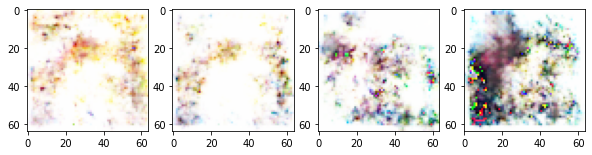

Epoch Number 40


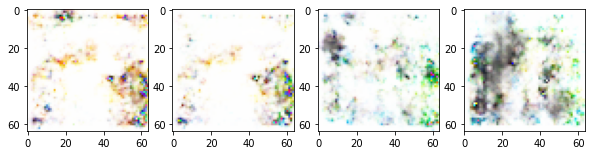

Epoch Number 60


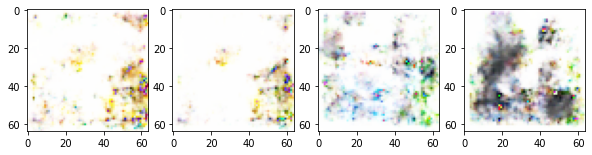

Epoch Number 80


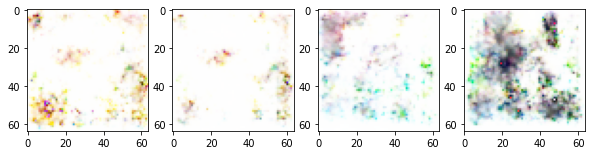

Epoch Number 100


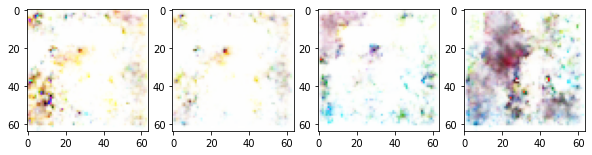

Epoch Number 120


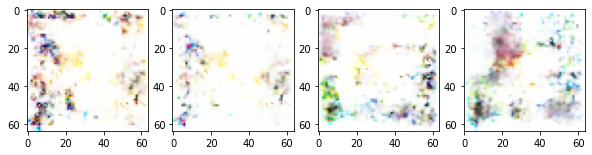

Epoch Number 140


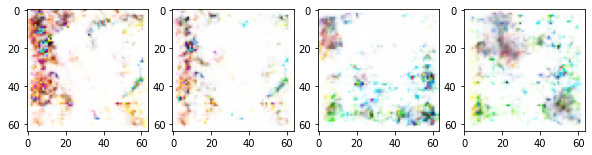

Epoch Number 160


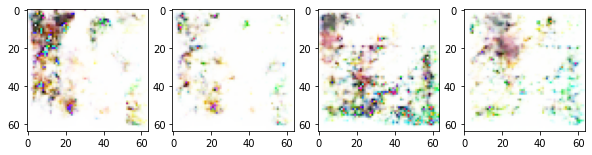

Epoch Number 180


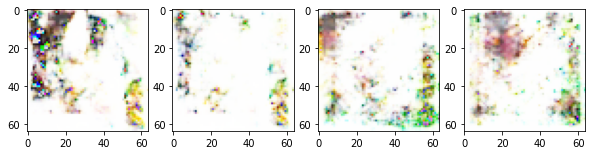

Epoch Number 200


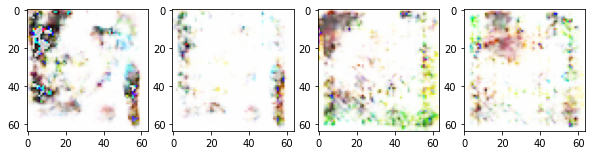

Epoch Number 220


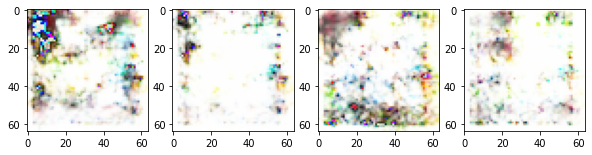

Epoch Number 240


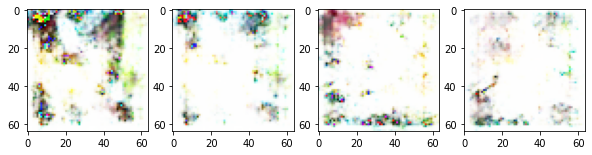

Epoch Number 260


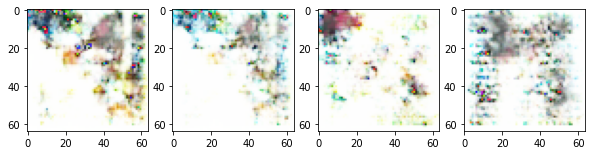

Epoch Number 280


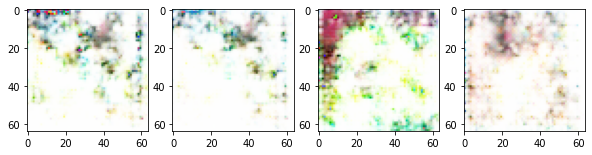

Epoch Number 300


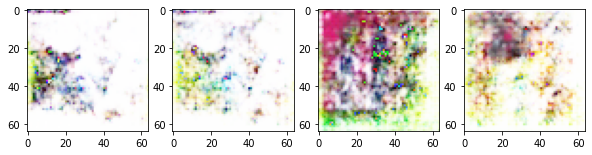

Epoch Number 320


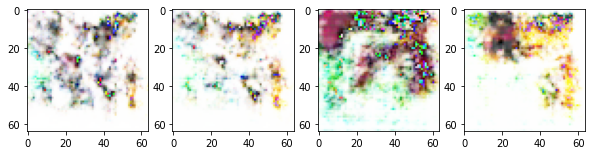

Epoch Number 340


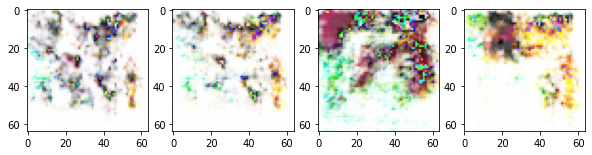

Epoch Number 360


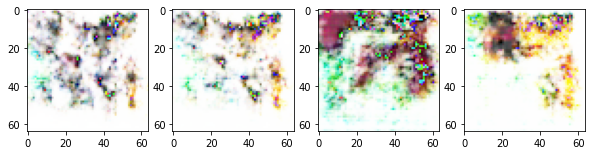

Epoch Number 380


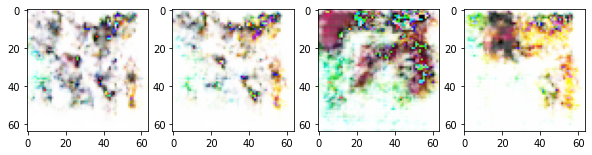

Epoch Number 400


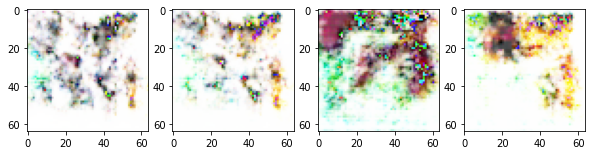

Epoch Number 420


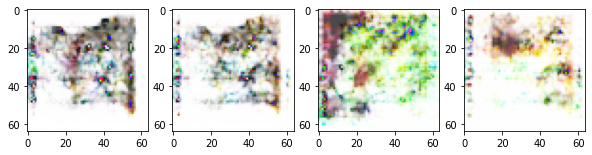

Epoch Number 440


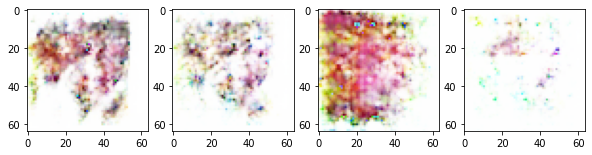

Epoch Number 460


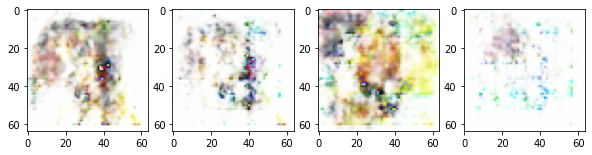

Epoch Number 480


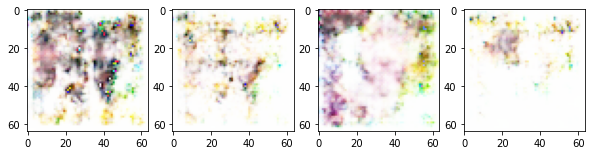

Epoch Number 500


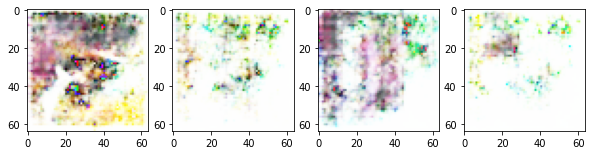

Epoch Number 520


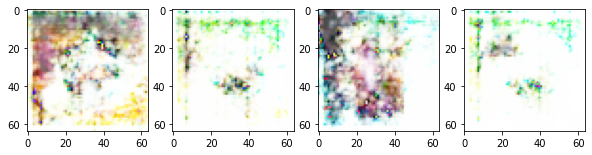

Epoch Number 540


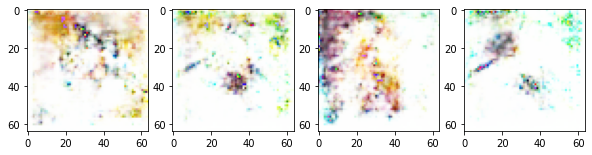

Epoch Number 560


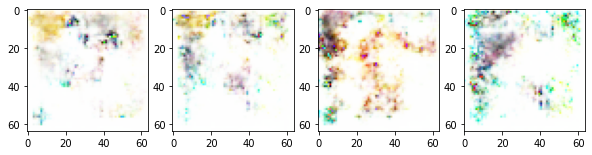

Epoch Number 580


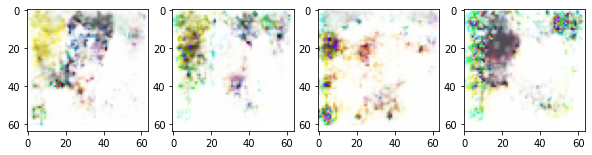

Epoch Number 600


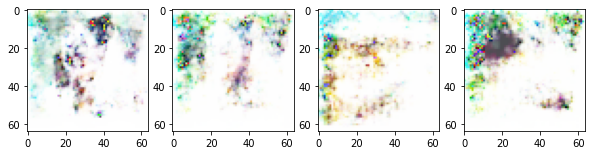

Epoch Number 620


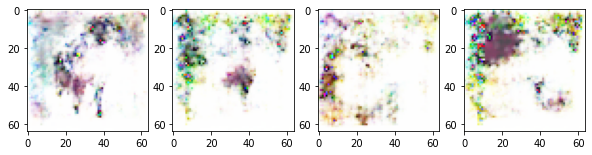

Epoch Number 640


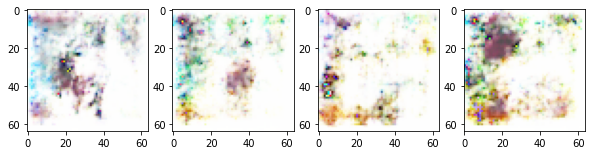

Epoch Number 660


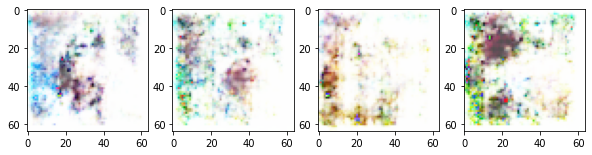

Epoch Number 680


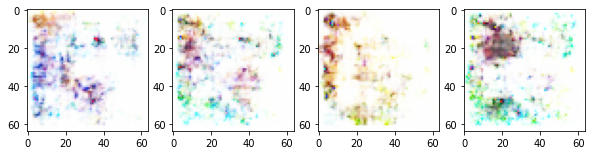

Epoch Number 700


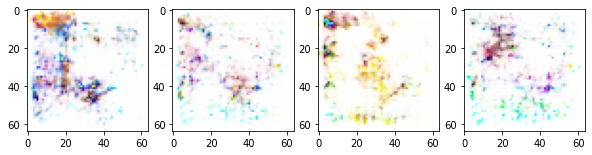

Epoch Number 720


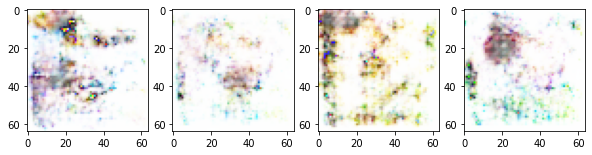

Epoch Number 740


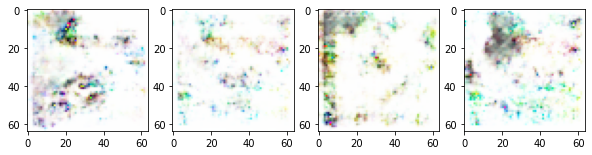

Epoch Number 760


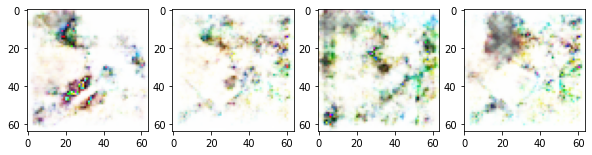

Epoch Number 780


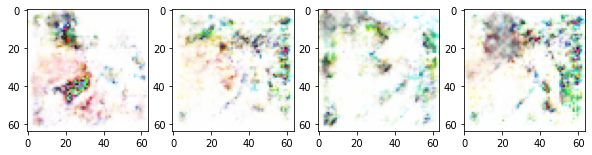

Epoch Number 800


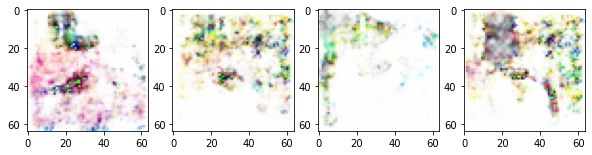

Epoch Number 820


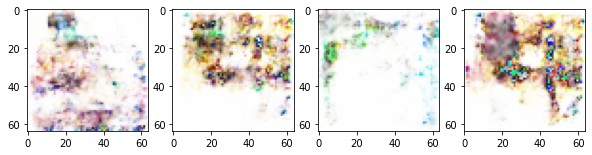

Epoch Number 840


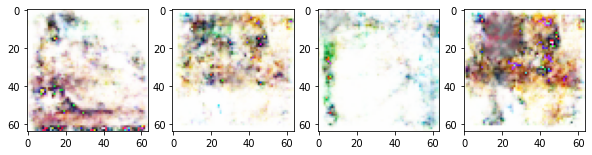

Epoch Number 860


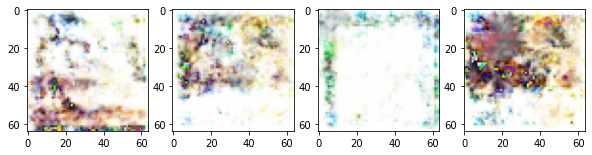

Epoch Number 880


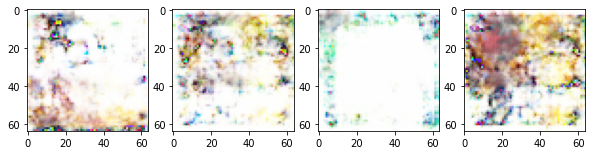

Epoch Number 900


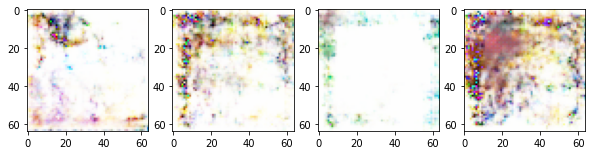

Epoch Number 920


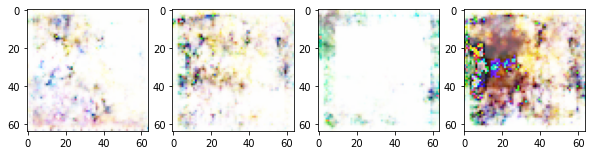

Epoch Number 940


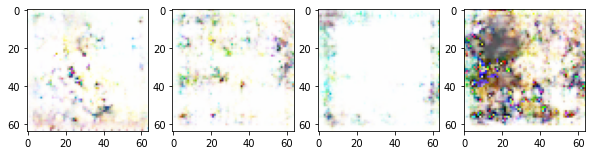

Epoch Number 960


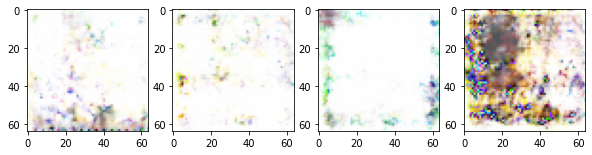

Epoch Number 980


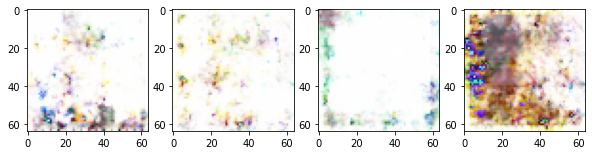

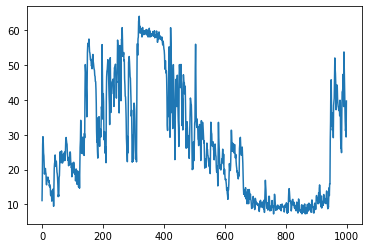

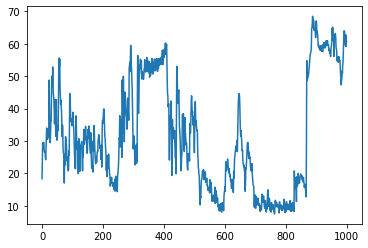

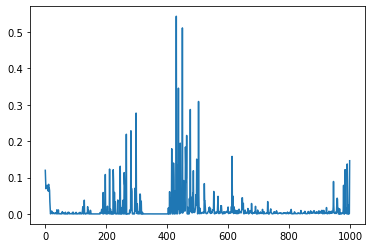

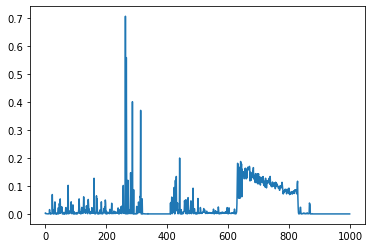

In [0]:
G, D1, D2 = scope(G, D1, D2, stl_data_loader1, stl_data_loader2)

Epoch Number 0


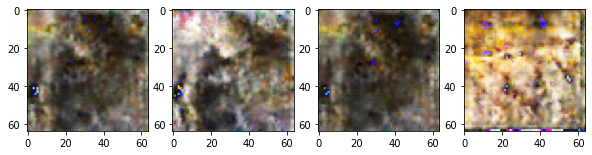

Epoch Number 0


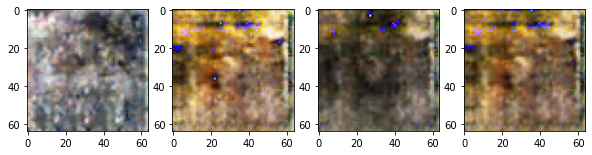

Epoch Number 0


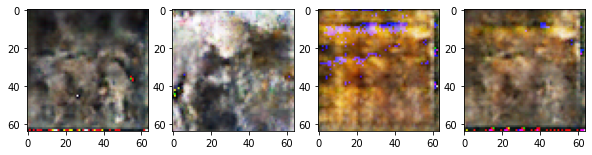

Epoch Number 0


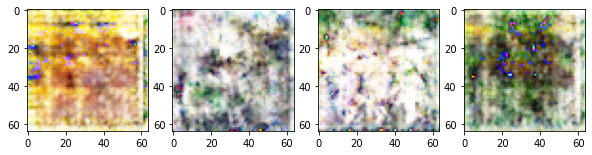

Epoch Number 0


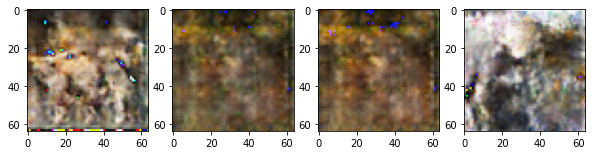

Epoch Number 0


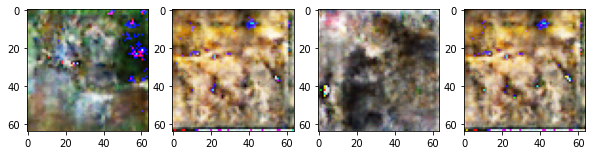

Epoch Number 0


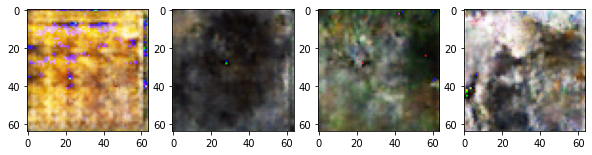

Epoch Number 0


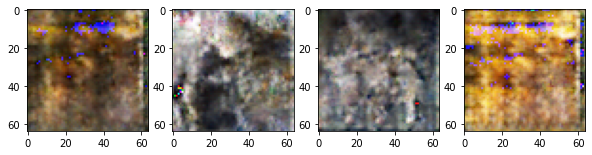

Epoch Number 0


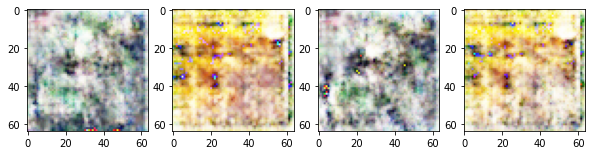

Epoch Number 0


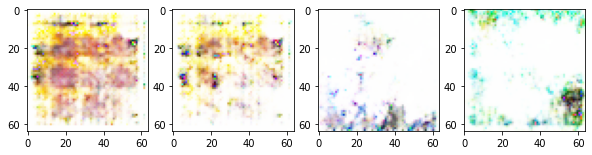

In [0]:
for i in range(10):
  showImages(G, noise(4), 0)

In [0]:
torch.save(G.state_dict(), '/content/drive/My Drive/Gct2')
torch.save(D1.state_dict(), '/content/drive/My Drive/D1ct2')
torch.save(D2.state_dict(), '/content/drive/My Drive/D2ct2')